In [1]:
# 3. Import libraries and modules
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
np.random.seed(123)  # for reproducibility
import os
import matplotlib
from PIL import Image

import keras
print keras.__version__

from keras import backend as K
K.set_image_dim_ordering('tf')
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Convolution2D, MaxPooling2D
from keras.utils import np_utils
from keras.optimizers import SGD
import theano
import scipy as sp
#from keras.datasets import mnist

Using Theano backend.
WARNING (theano.gof.compilelock): Overriding existing lock by dead process '14730' (I am process '23603')


1.0.8


Using gpu device 0: Tesla K80 (CNMeM is disabled, cuDNN 5103)
/usr/local/lib/python2.7/site-packages/Theano-0.8.2-py2.7.egg/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)


In [14]:
save_path = './class6images_n2800_size128/'

In [15]:
dir_path='./matrices2800/'

del_count = 0
inv_count = 0
size = 128

for root, dirs, files in os.walk(dir_path, topdown=False):
    for name in files: # loop through all the files in /matrices2800/
        if "DEL_Raw" in name:
            load = np.loadtxt(os.path.join(root, name))
            # take log
            img = np.log2(load)
            # save name
            save_name = save_path+name[:-4]+".jpg"
            # save image
            matplotlib.image.imsave(save_name, img)
            # read image again, it will be (256, 256, 3)
            pil_im = Image.open(save_name)
            # resize
            out = pil_im.resize((size,size))
            # overwirte the resized image
            out.save(save_name)
            # add counter
            del_count += 1

        elif "_INV_Raw" in name:
            load = np.loadtxt(os.path.join(root, name))
            # take log
            img = np.log2(load)
            # save name
            save_name = save_path+name[:-4]+".jpg"
            # save image
            matplotlib.image.imsave(save_name, img)
            # read image again, it will be (256, 256, 3)
            pil_im = Image.open(save_name)
            # resize
            out = pil_im.resize((size,size))
            # overwirte the resized image
            out.save(save_name)
            # add counter
            inv_count += 1


print del_count, inv_count, "DEL,  INV,   Image save Done."

2800 2800 DEL,  INV,   Image save Done.


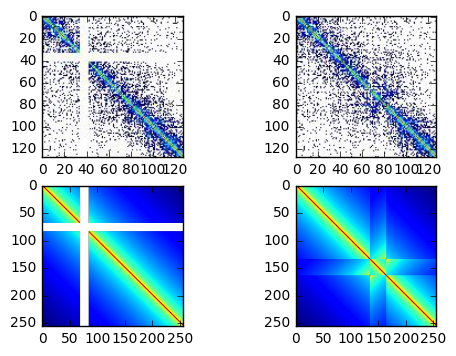

In [16]:
del_test = Image.open("./class6images_n2800_size128/GM12878_tt_chr11_region1016_DEL_Raw.jpg")
inv_test = Image.open("./class6images_n2800_size128/GM12878_tt_chr11_region1016_INV_Raw.jpg")
del_expected = np.log2(np.loadtxt("./matrices2800/GM12878_tt_chr11_region1016_DEL_Expected.txt"))
inv_expected = np.log2(np.loadtxt("./matrices2800/GM12878_tt_chr11_region1016_INV_Expected.txt"))

fig, axes = plt.subplots(nrows=2, ncols=2)
axes.flat[0].imshow(del_test)
axes.flat[1].imshow(inv_test)
axes.flat[2].imshow(del_expected)
axes.flat[3].imshow(inv_expected)

plt.show()

In [17]:
dir_path='./INSDUPmatrices/'

ins_count = 0
insinv_count = 0
dup_count = 0
size = 128

for root, dirs, files in os.walk(dir_path, topdown=False):
    for name in files: # loop through all the files in /INSDUPmatrices/
        if "_INS_Raw" in name:
            load = np.loadtxt(os.path.join(root, name))
            # take log
            img = np.log2(load)
            # save name
            save_name = save_path+name[:-4]+".jpg"
            # save image
            matplotlib.image.imsave(save_name, img)
            # read image again, it will be (256, 256, 3)
            pil_im = Image.open(save_name)
            # resize
            out = pil_im.resize((size,size))
            # overwirte the resized image
            out.save(save_name)
            # add counter
            ins_count += 1
            
        
        elif "_INSINV_Raw" in name:
            load = np.loadtxt(os.path.join(root, name))
            # take log
            img = np.log2(load)
            # save name
            save_name = save_path+name[:-4]+".jpg"
            # save image
            matplotlib.image.imsave(save_name, img)
            # read image again, it will be (256, 256, 3)
            pil_im = Image.open(save_name)
            # resize
            out = pil_im.resize((size,size))
            # overwirte the resized image
            out.save(save_name)
            # add counter
            insinv_count += 1
            
            
        elif "_DUP_Raw" in name:
            load = np.loadtxt(os.path.join(root, name))
            # take log
            img = np.log2(load)
            # save name
            save_name = save_path+name[:-4]+".jpg"
            # save image
            matplotlib.image.imsave(save_name, img)
            # read image again, it will be (256, 256, 3)
            pil_im = Image.open(save_name)
            # resize
            out = pil_im.resize((size,size))
            # overwirte the resized image
            out.save(save_name)
            # add counter
            dup_count += 1

print ins_count, insinv_count, dup_count, "INS,  INSINV,   DUP,    Image save Done."

2800 2800 2800 INS,  INSINV,   DUP,    Image save Done.


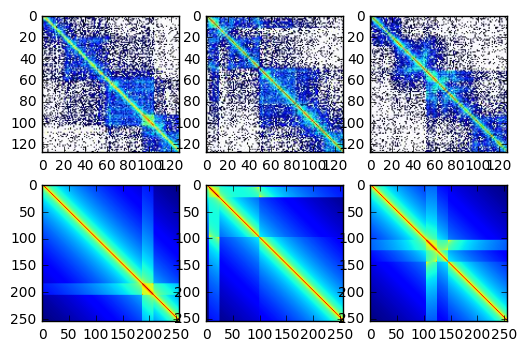

In [18]:
dup_test = Image.open("./class6images_n2800_size128/GM12878_tt_chr10_region1140_DUP_Raw.jpg")
ins_test = Image.open("./class6images_n2800_size128/GM12878_tt_chr10_region1140_INS_Raw.jpg")
insinv_test = Image.open("./class6images_n2800_size128/GM12878_tt_chr10_region1026_INSINV_Raw.jpg")

dup_expected = np.log2(np.loadtxt("./INSDUPmatrices/GM12878_tt_chr10_region1140_DUP_Expected.txt"))
ins_expected = np.log2(np.loadtxt("./INSDUPmatrices/GM12878_tt_chr10_region1140_INS_Expected.txt"))
insinv_expected = np.log2(np.loadtxt("./INSDUPmatrices/GM12878_tt_chr10_region1026_INSINV_Expected.txt"))

fig, axes = plt.subplots(nrows=2, ncols=3)
axes.flat[0].imshow(dup_test)
axes.flat[1].imshow(ins_test)
axes.flat[2].imshow(insinv_test)
axes.flat[3].imshow(dup_expected)
axes.flat[4].imshow(ins_expected)
axes.flat[5].imshow(insinv_expected)

plt.show()

In [19]:
dir_path='./non_feature_matrices/'

non_feature_count = 0
size = 128

for root, dirs, files in os.walk(dir_path, topdown=False):
    for name in files: # loop through all the files in /non_feature_matrices/
        if "expected" not in name:
            load = np.loadtxt(os.path.join(root, name))
            # take log
            img = np.log2(load)
            # save name
            save_name = save_path+name[:-4]+".jpg"
            # save image
            matplotlib.image.imsave(save_name, img)
            # read image again, it will be (256, 256, 3)
            pil_im = Image.open(save_name)
            # resize to (224, 224)
            out = pil_im.resize((size,size))
            # overwirte the resized image
            out.save(save_name)
            
            non_feature_count += 1



print non_feature_count, "Non-Feature    Image save Done."

2800 Non-Feature    Image save Done.


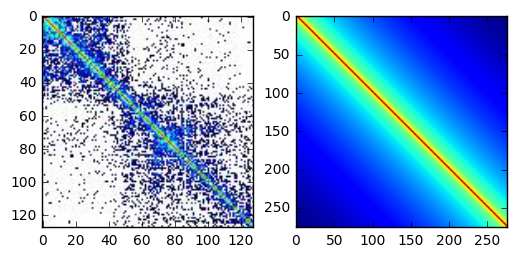

In [20]:
non_feature = Image.open("./class6images_n2800_size128/GM12878_tt_chr10_region1113_matrix.jpg")
non_feature_expected = np.log2(np.loadtxt("./non_feature_matrices/GM12878_tt_chr10_region1113_expected_matrix.txt"))

fig, axes = plt.subplots(nrows=1, ncols=2)
axes.flat[0].imshow(non_feature)
axes.flat[1].imshow(non_feature_expected)

In [6]:
from random import shuffle

dir_path='./class6images_n2800_size128/'
X_data = []
y_data = []

for root, dirs, files in os.walk(dir_path, topdown=False):
    shuffle(files)  # shuffle so that we can distribute 6 classes evenly
    for name in files: # loo through all the files in /class6images/
        img = plt.imread(os.path.join(root, name))
        X_data.append(img)
        if "_DEL_" in name:
            y_data.append(0)
        elif "_DUP_" in name:
            y_data.append(1)
        elif "_INSINV_" in name:
            y_data.append(2)
        elif "_INS_" in name:
            y_data.append(3)
        elif "_INV_" in name:
            y_data.append(4)
        elif "_matrix" in name:
            y_data.append(5)

print len(X_data), len(y_data)
print "Input Reading Done."

16800 16800
Input Reading Done.


(128, 128, 3) 4
(128, 128, 3) 2
(128, 128, 3) 2
(128, 128, 3) 4
(128, 128, 3) 2
(128, 128, 3) 0
[5, 0, 4, 3, 4, 4, 0, 1, 3, 1, 2, 4, 2, 4, 3, 4, 5, 5, 1, 4, 1, 0, 2, 1, 2, 0, 5, 4, 0, 2, 2, 5, 4, 0, 1, 5, 0, 5, 3, 0, 2, 4, 2, 3, 4, 3, 1, 5, 3, 0, 2, 4, 1, 5, 2, 2, 5, 3, 0, 2, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1, 0, 0, 2, 0, 5, 4, 1, 0, 4, 0, 4, 2, 3, 3, 2, 0, 2, 4, 0, 3, 4, 1, 5, 0, 0, 4, 0, 2, 4]
20 14 22 13 19 12


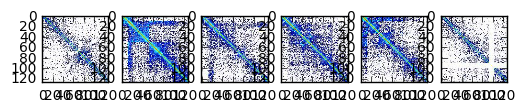

In [3]:
i = 12800
for k in range(6):
    print X_data[i+k].shape, y_data[i+k]

fig, axes = plt.subplots(nrows=1, ncols=6)
for k in range(6):
    axes.flat[k].imshow(X_data[i+k])

print y_data[:100]
print y_data[:100].count(0), y_data[:100].count(1), y_data[:100].count(2), y_data[:100].count(3), y_data[:100].count(4), y_data[:100].count(5)

In [7]:
split = 15000 # Use 90% of dataset for Train
num_classes = 6

X = np.asarray(X_data)
#X = X.transpose(0,3,1,2)
print X.shape


X_train, X_test = X[:split], X[split:]
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
X_train /= 255.
X_test /= 255.
print X_train.shape, X_test.shape
print X_train[0].shape

y = np.asarray(y_data)
print y.shape


y_train, y_test = y[:split], y[split:]
print y_train.shape, y_test.shape
print type(y_test), y_test

# 6. Preprocess class labels
Y_train = np_utils.to_categorical(y_train, num_classes)
Y_test = np_utils.to_categorical(y_test, num_classes)
print Y_train.shape

(16800, 128, 128, 3)
(15000, 128, 128, 3) (1800, 128, 128, 3)
(128, 128, 3)
(16800,)
(15000,) (1800,)
<type 'numpy.ndarray'> [5 2 5 ..., 4 4 2]
(15000, 6)


(128, 128, 3) 0
(128, 128, 3) 1
(128, 128, 3) 1
(128, 128, 3) 1
(128, 128, 3) 1
(128, 128, 3) 3
[5 0 4 3 4 4 0 1 3 1 2 4 2 4 3 4 5 5 1 4 1 0 2 1 2 0 5 4 0 2 2 5 4 0 1 5 0
 5 3 0 2 4 2 3 4 3 1 5 3 0 2 4 1 5 2 2 5 3 0 2 3 3 2 2 2 2 2 1 1 1 1 0 0 2
 0 5 4 1 0 4 0 4 2 3 3 2 0 2 4 0 3 4 1 5 0 0 4 0 2 4]


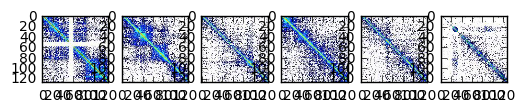

In [5]:
i = 1009
for k in range(6):
    print X_train[i+k].shape, y_train[i+k]

fig, axes = plt.subplots(nrows=1, ncols=6)
for k in range(6):
    axes.flat[k].imshow(X_train[i+k])

print y_train[:100]

In [4]:
# build the VGG16 network
import h5py
from keras import optimizers
from keras.models import Sequential
from keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.layers import Activation, Dropout, Flatten, Dense
K.set_image_dim_ordering('th')

filter_size = 20
num_classes = 6
size = 128

weights_path = 'vgg16_weights.h5'

model = Sequential()
model.add(ZeroPadding2D((1, 1), input_shape=(3,size,size)))

# model.add(Convolution2D(32, 20, 20, activation='relu', name='conv0_1'))
# model.add(ZeroPadding2D((1, 1)))
# model.add(Convolution2D(32, 20, 20, activation='relu', name='conv0_2'))
# model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# #model.add(Flatten(input_shape=(64,3,3,3)))

# model.add(ZeroPadding2D((1, 1), input_shape=(64,3,3,3)))

model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))



# load the weights of the VGG16 networks
# (trained on ImageNet, won the ILSVRC competition in 2014)
# note: when there is a complete match between your model definition
# and your weight savefile, you can simply call model.load_weights(filename)
assert os.path.exists(weights_path), 'Model weights not found (see "weights_path" variable in script).'
f = h5py.File(weights_path)
for k in range(f.attrs['nb_layers']):
    if k >= len(model.layers):
        # we don't look at the last (fully-connected) layers in the savefile
        break
    g = f['layer_{}'.format(k)]
    weights = [g['param_{}'.format(p)] for p in range(g.attrs['nb_params'])]
    model.layers[k].set_weights(weights)
f.close()
print('Model loaded.')

# build a classifier model to put on top of the convolutional model
top_model = Sequential()
top_model.add(Flatten(input_shape=model.output_shape[1:]))
top_model.add(Dense(256, activation='relu'))
top_model.add(Dropout(0.5))
top_model.add(Dense(num_classes, activation='softmax'))

# model.add(Flatten(input_shape=model.output_shape[1:]))
# model.add(Dense(256, activation='relu'))
# model.add(Dropout(0.5))
# model.add(Dense(num_classes, activation='softmax'))


# note that it is necessary to start with a fully-trained
# classifier, including the top classifier,
# in order to successfully do fine-tuning
#top_model.load_weights(top_model_weights_path)

# add the model on top of the convolutional base
model.add(top_model)


# set the first 25 layers (up to the last conv block)
# to non-trainable (weights will not be updated)
# for layer in model.layers[:25]:
#     layer.trainable = False

    
model.summary()

Model loaded.
____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
zeropadding2d_1 (ZeroPadding2D)  (None, 3, 130, 130)   0           zeropadding2d_input_1[0][0]      
____________________________________________________________________________________________________
conv1_1 (Convolution2D)          (None, 64, 128, 128)  1792        zeropadding2d_1[0][0]            
____________________________________________________________________________________________________
zeropadding2d_2 (ZeroPadding2D)  (None, 64, 130, 130)  0           conv1_1[0][0]                    
____________________________________________________________________________________________________
conv1_2 (Convolution2D)          (None, 64, 128, 128)  36928       zeropadding2d_2[0][0]            
_____________________________________________________________________________

In [8]:
X_train_transpose = X_train.transpose(0,3,1,2)
X_test_transpose = X_test.transpose(0,3,1,2)
print X_train_transpose.shape, X_test_transpose.shape
print Y_train.shape

(15000, 3, 128, 128) (1800, 3, 128, 128)
(15000, 6)


In [ ]:
sgd = SGD(lr=0.0001, decay=1e-6, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=50, validation_data=(X_test_transpose, Y_test))

Train on 15000 samples, validate on 1800 samples
Epoch 1/50
15000/15000 [==============================] - 808s - loss: 1.3586 - acc: 0.4405 - val_loss: 0.9137 - val_acc: 0.6017
Epoch 2/50
15000/15000 [==============================] - 810s - loss: 0.8768 - acc: 0.6199 - val_loss: 0.7550 - val_acc: 0.6539
Epoch 3/50
15000/15000 [==============================] - 808s - loss: 0.7545 - acc: 0.6627 - val_loss: 0.6431 - val_acc: 0.6994
Epoch 4/50
15000/15000 [==============================] - 807s - loss: 0.6618 - acc: 0.7065 - val_loss: 0.5864 - val_acc: 0.7200
Epoch 5/50
15000/15000 [==============================] - 807s - loss: 0.5927 - acc: 0.7367 - val_loss: 0.5338 - val_acc: 0.7472
Epoch 6/50
 2950/15000 [====>.........................] - ETA: 621s - loss: 0.5590 - acc: 0.7573

# Exp1 : all trainable, fixed learning rate

In [8]:
sgd = SGD(lr=0.0001, decay=1e-6, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=50, validation_data=(X_test_transpose, Y_test))

Train on 15000 samples, validate on 1800 samples
Epoch 1/50
15000/15000 [==============================] - 415s - loss: 1.3567 - acc: 0.4401 - val_loss: 0.8539 - val_acc: 0.6517
Epoch 2/50
15000/15000 [==============================] - 417s - loss: 0.8729 - acc: 0.6178 - val_loss: 0.7203 - val_acc: 0.6756
Epoch 3/50
15000/15000 [==============================] - 417s - loss: 0.7523 - acc: 0.6633 - val_loss: 0.6528 - val_acc: 0.6900
Epoch 4/50
15000/15000 [==============================] - 417s - loss: 0.6780 - acc: 0.6989 - val_loss: 0.5937 - val_acc: 0.7228
Epoch 5/50
15000/15000 [==============================] - 418s - loss: 0.6063 - acc: 0.7302 - val_loss: 0.5284 - val_acc: 0.7467
Epoch 6/50
15000/15000 [==============================] - 419s - loss: 0.5435 - acc: 0.7521 - val_loss: 0.4997 - val_acc: 0.7617
Epoch 7/50
15000/15000 [==============================] - 419s - loss: 0.5072 - acc: 0.7643 - val_loss: 0.4600 - val_acc: 0.7717
Epoch 8/50
15000/15000 [========================

KeyboardInterrupt: 

In [9]:
# save the model
model.save('6class_n2800_size128_95acc_alltrainable_fixed_lr.h5')

In [6]:
# 10. Evaluate model on test data
score = model.evaluate(X_test_transpose, Y_test, verbose=1)
score

NameError: name 'X_test_transpose' is not defined

# Exp2 : 25 layers non trainable, fixed learning rate

In [32]:
# build the VGG16 network
import h5py
from keras import optimizers
from keras.models import Sequential
from keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.layers import Activation, Dropout, Flatten, Dense
K.set_image_dim_ordering('th')

filter_size = 20
num_classes = 6
size = 128

weights_path = 'vgg16_weights.h5'

model = Sequential()
model.add(ZeroPadding2D((1, 1), input_shape=(3,size,size)))

# model.add(Convolution2D(32, 20, 20, activation='relu', name='conv0_1'))
# model.add(ZeroPadding2D((1, 1)))
# model.add(Convolution2D(32, 20, 20, activation='relu', name='conv0_2'))
# model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# #model.add(Flatten(input_shape=(64,3,3,3)))

# model.add(ZeroPadding2D((1, 1), input_shape=(64,3,3,3)))

model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))



# load the weights of the VGG16 networks
# (trained on ImageNet, won the ILSVRC competition in 2014)
# note: when there is a complete match between your model definition
# and your weight savefile, you can simply call model.load_weights(filename)
assert os.path.exists(weights_path), 'Model weights not found (see "weights_path" variable in script).'
f = h5py.File(weights_path)
for k in range(f.attrs['nb_layers']):
    if k >= len(model.layers):
        # we don't look at the last (fully-connected) layers in the savefile
        break
    g = f['layer_{}'.format(k)]
    weights = [g['param_{}'.format(p)] for p in range(g.attrs['nb_params'])]
    model.layers[k].set_weights(weights)
f.close()
print('Model loaded.')

# build a classifier model to put on top of the convolutional model
# top_model = Sequential()
# top_model.add(Flatten(input_shape=model.output_shape[1:]))
# top_model.add(Dense(256, activation='relu'))
# top_model.add(Dropout(0.5))
# top_model.add(Dense(num_classes, activation='softmax'))

model.add(Flatten(input_shape=model.output_shape[1:]))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))


# note that it is necessary to start with a fully-trained
# classifier, including the top classifier,
# in order to successfully do fine-tuning
#top_model.load_weights(top_model_weights_path)

# add the model on top of the convolutional base
#model.add(top_model)


# set the first 25 layers (up to the last conv block)
# to non-trainable (weights will not be updated)
for layer in model.layers[:25]:
    layer.trainable = False

    
model.summary()

Model loaded.
____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
zeropadding2d_53 (ZeroPadding2D) (None, 3, 130, 130)   0           zeropadding2d_input_5[0][0]      
____________________________________________________________________________________________________
conv1_1 (Convolution2D)          (None, 64, 128, 128)  1792        zeropadding2d_53[0][0]           
____________________________________________________________________________________________________
zeropadding2d_54 (ZeroPadding2D) (None, 64, 130, 130)  0           conv1_1[0][0]                    
____________________________________________________________________________________________________
conv1_2 (Convolution2D)          (None, 64, 128, 128)  36928       zeropadding2d_54[0][0]           
_____________________________________________________________________________

In [ ]:
sgd = SGD(lr=0.0001, decay=1e-6, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=25, validation_data=(X_test_transpose, Y_test))

Train on 15000 samples, validate on 1800 samples
Epoch 1/25
15000/15000 [==============================] - 160s - loss: 1.5133 - acc: 0.3747 - val_loss: 1.2730 - val_acc: 0.5156
Epoch 2/25
15000/15000 [==============================] - 162s - loss: 1.2021 - acc: 0.5079 - val_loss: 1.0569 - val_acc: 0.5656
Epoch 3/25
15000/15000 [==============================] - 163s - loss: 1.0313 - acc: 0.5789 - val_loss: 0.9359 - val_acc: 0.5972
Epoch 4/25
15000/15000 [==============================] - 163s - loss: 0.9186 - acc: 0.6137 - val_loss: 0.8508 - val_acc: 0.6217
Epoch 5/25
15000/15000 [==============================] - 163s - loss: 0.8563 - acc: 0.6319 - val_loss: 0.8184 - val_acc: 0.6333
Epoch 6/25
15000/15000 [==============================] - 163s - loss: 0.8142 - acc: 0.6442 - val_loss: 0.7878 - val_acc: 0.6333
Epoch 7/25
15000/15000 [==============================] - 163s - loss: 0.7835 - acc: 0.6560 - val_loss: 0.7735 - val_acc: 0.6300
Epoch 8/25
15000/15000 [========================

# Exp3 : non-trainable & learning rate annealing

In [8]:
sgd = SGD(lr=0.01, decay=0.01, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=25, validation_data=(X_test_transpose, Y_test))

Train on 15000 samples, validate on 1800 samples
Epoch 1/25
15000/15000 [==============================] - 158s - loss: 1.8099 - acc: 0.1584 - val_loss: 1.7921 - val_acc: 0.1500
Epoch 2/25
15000/15000 [==============================] - 160s - loss: 1.7919 - acc: 0.1627 - val_loss: 1.7921 - val_acc: 0.1500
Epoch 3/25
15000/15000 [==============================] - 160s - loss: 1.7918 - acc: 0.1677 - val_loss: 1.7921 - val_acc: 0.1500
Epoch 4/25
15000/15000 [==============================] - 160s - loss: 1.7918 - acc: 0.1651 - val_loss: 1.7922 - val_acc: 0.1500
Epoch 5/25
 1400/15000 [=>............................] - ETA: 131s - loss: 1.7919 - acc: 0.1643

KeyboardInterrupt: 

# Ex4 : all trainable layers + step learning rate

In [10]:
sgd = SGD(lr=0.01, decay=0.01, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=25, validation_data=(X_test_transpose, Y_test))

Train on 15000 samples, validate on 1800 samples
Epoch 1/25
15000/15000 [==============================] - 397s - loss: 13.2678 - acc: 0.1659 - val_loss: 13.3512 - val_acc: 0.1717
Epoch 2/25
15000/15000 [==============================] - 398s - loss: 13.4436 - acc: 0.1659 - val_loss: 13.3512 - val_acc: 0.1717
Epoch 3/25
 1650/15000 [==>...........................] - ETA: 341s - loss: 13.3927 - acc: 0.1691

KeyboardInterrupt: 

In [12]:
sgd = SGD(lr=0.001, decay=1e-6, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=50, validation_data=(X_test_transpose, Y_test))

Train on 15000 samples, validate on 1800 samples
Epoch 1/50
15000/15000 [==============================] - 414s - loss: 1.2258 - acc: 0.4630 - val_loss: 0.7710 - val_acc: 0.6161
Epoch 2/50
15000/15000 [==============================] - 415s - loss: 0.8059 - acc: 0.6193 - val_loss: 0.6371 - val_acc: 0.6967
Epoch 3/50
15000/15000 [==============================] - 415s - loss: 0.5627 - acc: 0.7289 - val_loss: 0.3899 - val_acc: 0.7867
Epoch 4/50
15000/15000 [==============================] - 414s - loss: 0.4309 - acc: 0.7801 - val_loss: 0.3494 - val_acc: 0.8017
Epoch 5/50
15000/15000 [==============================] - 414s - loss: 0.3841 - acc: 0.7953 - val_loss: 0.3493 - val_acc: 0.8156
Epoch 6/50
15000/15000 [==============================] - 413s - loss: 0.3474 - acc: 0.8175 - val_loss: 0.3158 - val_acc: 0.8378
Epoch 7/50
15000/15000 [==============================] - 413s - loss: 0.2952 - acc: 0.8651 - val_loss: 0.2475 - val_acc: 0.8928
Epoch 8/50
15000/15000 [========================

KeyboardInterrupt: 

In [ ]:
# save the model
model.save('6class_n2800_size128_95acc_alltrainable_fixed_lr.h5')

In [ ]:
from keras.callbacks import ModelCheckpoint

'''
saves the model weights after each epoch if the validation loss decreased
'''
checkpointer = ModelCheckpoint(filepath="6class_n2800_size128_95val_acc_all_trainable_lr001.hdf5", verbose=1, save_best_only=True, monitor='val_acc', mode='max')

# sgd = SGD(lr=0.001, decay=1e-6, momentum=0.9, nesterov=True)
# model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=25, validation_data=(X_test_transpose, Y_test), callbacks=[checkpointer], verbose=0)

Epoch 00000: val_acc improved from -inf to 0.93056, saving model to 6class_n2800_size128_95val_acc_all_trainable_lr001.hdf5


In [6]:
model.load_weights("6class_n2800_size128_95acc_alltrainable_fixed_lr.h5")
# Compile model (required to make predictions)
sgd = SGD(lr=0.001, decay=1e-6, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])
print("Created model and loaded weights from file")

# 10. Evaluate model on test data
score = model.evaluate(X_test_transpose, Y_test, verbose=1)
score

Created model and loaded weights from file
1800/1800 [==============================] - 14s    


[0.11838672035270267, 0.94888888888888889]

In [9]:
model.load_weights("6class_n2800_size128_95val_acc_all_trainable_lr001.hdf5")
# Compile model (required to make predictions)
sgd = SGD(lr=0.001, decay=1e-6, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])
print("Created model and loaded weights from file")

# 10. Evaluate model on test data
score = model.evaluate(X_test_transpose, Y_test, verbose=1)
score

Created model and loaded weights from file
1800/1800 [==============================] - 14s    


[0.0513298848471863, 0.98333333333333328]

# Application

In [10]:
label = ["DEL", "DUP", "INSINV", "INS", "INV", "non-feature"]

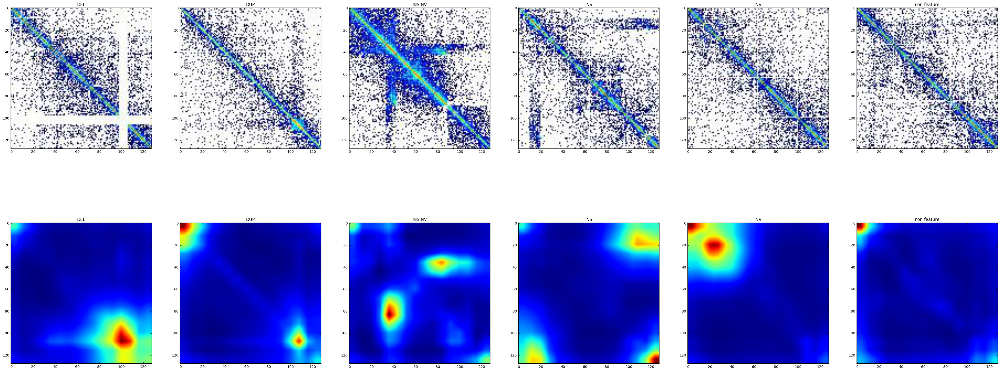

In [81]:
each_class_index = [145,146,147, 52, 255,40]
fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(50,20))
for k in range(len(each_class_index)):
    axes.flat[k].imshow(X_test[each_class_index[k]])
    axes.flat[k].set_title(label[y_test[each_class_index[k]]])
    
layers_extract = [22, 29]
for k in range(len(each_class_index)):
    im = np.asarray([X_test_transpose[each_class_index[k]]])
    hc = extract_hypercolumn(model, layers_extract, im)
    ave = np.average(hc.transpose(1, 2, 0), axis=2)
    axes.flat[k+6].imshow(ave)
    axes.flat[k+6].set_title(label[y_test[each_class_index[k]]])

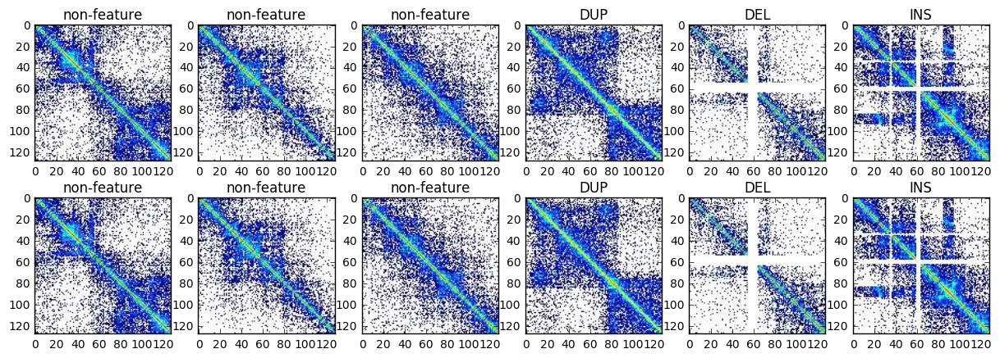

In [10]:
i=250
fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(15,5))
for k in range(6):
    axes.flat[k].imshow(X_test[i+k])
    axes.flat[k].set_title(label[y_test[i+k]])
    axes.flat[k+6].imshow(X_test[i+k])
    axes.flat[k+6].set_title(label[y_test[i+k]])

In [11]:
model.predict_classes(X_test_transpose[250:256])

6/6 [==============================] - 0s


array([5, 5, 5, 1, 0, 3])

plt.imshow(X_test[140])
inv_original = np.log2(np.loadtxt("./matrices2800/GM12878_tt_chr11_region1016_INV_Raw.txt"))
#plt.imshow(inv_original)

In [11]:
# from quiver_engine import server
# server.launch(model)
import quiver_engine
quiver_engine.server
#quiver_engine.server.launch(model, input_folder='./class6images_n2800_size128/')

AttributeError: 'module' object has no attribute 'server'

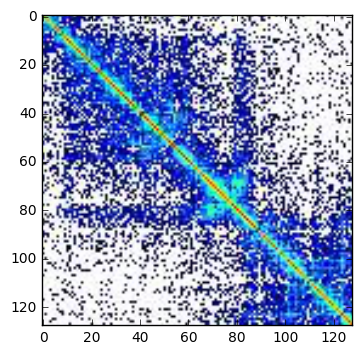

In [17]:
plt.imshow(X_test[140])
inv_original = np.log2(np.loadtxt("./matrices2800/GM12878_tt_chr11_region1016_INV_Raw.txt"))
#plt.imshow(inv_original)

[[  6.61807692e-11   3.19140714e-10   9.99999881e-01   5.99381025e-08
    1.11157210e-12   8.01473037e-12]]
1/1 [==============================] - 0s
INSINV
(1024, 128, 128)


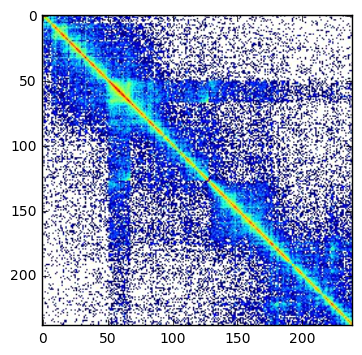

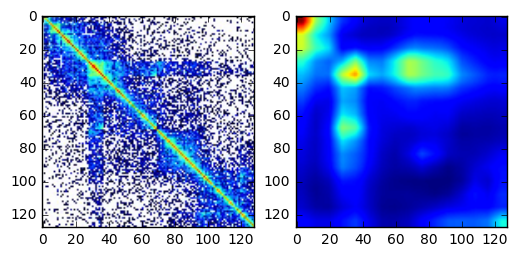

In [92]:
test = plt.imread("./images/INV8.jpg")
# i = 100
# stride = 700
# test = del0[i:i+stride, i:i+stride, ]
plt.imshow(test)
test = Image.fromarray(test)
test = test.resize((128,128))
test = np.asarray(test)
test_norm = test.astype('float32')
test_norm /= 255.
img = np.asarray([test_norm]).transpose(0,3,1,2)
print model.predict(img)
print label[model.predict_classes(img)[0]]

# visualize
fig, axes = plt.subplots(nrows=1, ncols=2)
axes.flat[0].imshow(test)

layers_extract = [22, 29]
hc = extract_hypercolumn(model, layers_extract, img)
print hc.shape
ave = np.average(hc.transpose(1, 2, 0), axis=2)
axes.flat[1].imshow(ave)

<type 'numpy.ndarray'> (1169, 1169, 3)


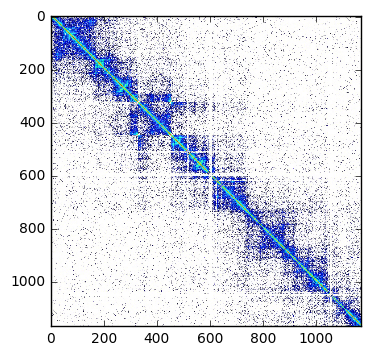

In [57]:
inv9 = plt.imread("INV9.jpg")
print type(inv9), inv9.shape
plt.imshow(inv9)

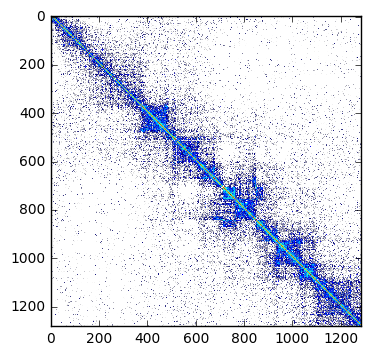

In [61]:
inv0 = np.loadtxt("GM12878_chr21_region6_INV_Raw.txt")
plt.imshow(np.log2(inv0))

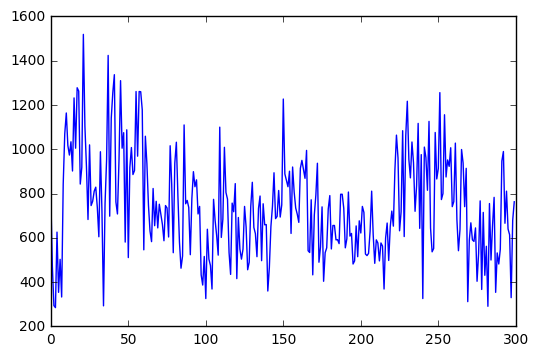

In [63]:
inv_rowsum = np.sum((inv0), axis=1)
plt.plot(inv_rowsum[700:1000])

(256,)
[[       -inf        -inf        -inf ...,        -inf        -inf
         -inf]
 [       -inf  7.56224242  5.28540222 ...,        -inf        -inf
         -inf]
 [       -inf  5.28540222  7.         ...,        -inf        -inf
         -inf]
 ..., 
 [       -inf        -inf        -inf ...,        -inf        -inf
         -inf]
 [       -inf  0.          0.         ...,        -inf        -inf
         -inf]
 [       -inf        -inf  0.         ...,        -inf        -inf
         -inf]]


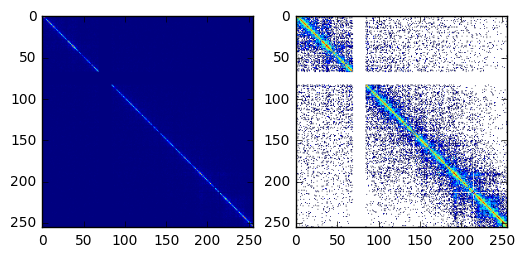

In [50]:
inv_matrix = np.loadtxt("./matrices2800/GM12878_tt_chr11_region1016_DEL_Raw.txt")
inv_rowsum = np.sum((inv_matrix), axis=1)
print inv_rowsum.shape
print np.log2(inv_matrix)[:100]

# visualize
fig, axes = plt.subplots(nrows=1, ncols=2)
axes.flat[0].imshow(inv_matrix)
axes.flat[1].imshow(np.log2(inv_matrix))

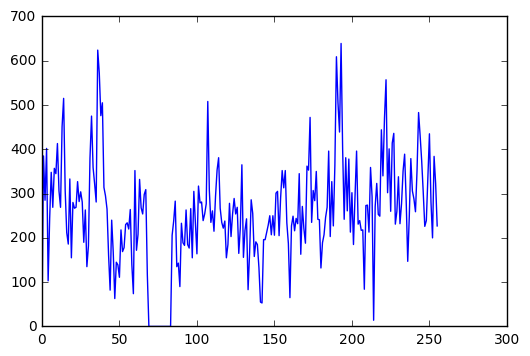

In [51]:
# visualize
plt.plot(inv_rowsum)

(256,)
[[       -inf        -inf        -inf ...,        -inf        -inf
         -inf]
 [       -inf  8.30833903  5.97727992 ...,        -inf        -inf
         -inf]
 [       -inf  5.97727992  7.4918531  ...,        -inf        -inf
         -inf]
 ..., 
 [       -inf  0.                -inf ...,        -inf        -inf
         -inf]
 [       -inf  0.                -inf ...,  0.                -inf
         -inf]
 [       -inf  1.                -inf ...,        -inf        -inf
         -inf]]


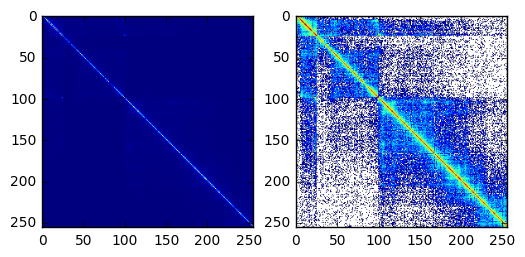

In [55]:
inv_matrix = np.loadtxt("./INSDUPmatrices/GM12878_tt_chr10_region1140_INS_Raw.txt")
inv_rowsum = np.sum((inv_matrix), axis=1)
print inv_rowsum.shape
print np.log2(inv_matrix)[:100]

# visualize
fig, axes = plt.subplots(nrows=1, ncols=2)
axes.flat[0].imshow(inv_matrix)
axes.flat[1].imshow(np.log2(inv_matrix))

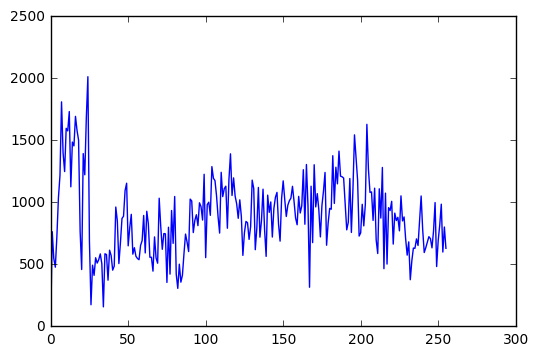

In [56]:
# visualize
plt.plot(inv_rowsum)

<class 'PIL.Image.Image'> (128, 128)
<type 'numpy.ndarray'> (128, 128, 3)
[[  3.74312629e-04   4.12698631e-04   3.48183908e-04   1.26553886e-03
    1.38416328e-03   9.96215165e-01]]
1/1 [==============================] - 0s
non-feature
(1024, 128, 128)


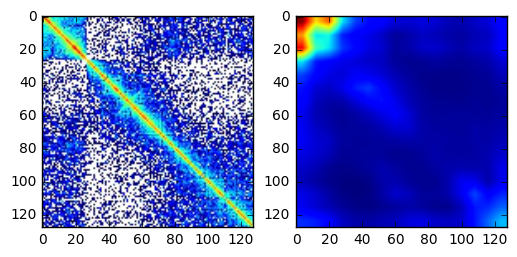

In [69]:
i = 300
stride = 128
test = inv9[i:i+stride, i:i+stride, ]
#test = inv9
test = Image.fromarray(test)
print type(test), test.size
test = test.resize((128,128))
test = np.asarray(test)
print type(test), test.shape
test_norm = test.astype('float32')
test_norm /= 255.
img = np.asarray([test_norm]).transpose(0,3,1,2)
print model.predict(img)
print label[model.predict_classes(img)[0]]

# visualize
fig, axes = plt.subplots(nrows=1, ncols=2)
axes.flat[0].imshow(test)

layers_extract = [22, 29]
hc = extract_hypercolumn(model, layers_extract, img)
print hc.shape
ave = np.average(hc.transpose(1, 2, 0), axis=2)
axes.flat[1].imshow(ave)

INSINV
1/1 [==============================] - 0s
INSINV


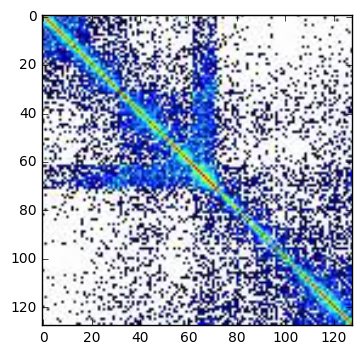

In [37]:
index=605
print(label[y_test[index]])
print label[model.predict_classes(np.asarray([X_test_transpose[index]]))[0]]
plt.imshow(X_test[index])

(192, 128, 128)
(1024, 128, 128)


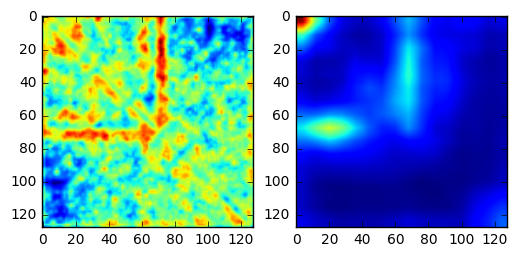

In [44]:
im = np.asarray([X_test_transpose[index]])
#im = img
layers_extract = [3, 8]
hc = extract_hypercolumn(model, layers_extract, im)
print hc.shape
ave = np.average(hc.transpose(1, 2, 0), axis=2)

fig, axes = plt.subplots(nrows=1, ncols=2)
axes.flat[0].imshow(ave)

layers_extract = [22, 29]
hc = extract_hypercolumn(model, layers_extract, im)
print hc.shape
ave = np.average(hc.transpose(1, 2, 0), axis=2)
axes.flat[1].imshow(ave)

ValueError: num must be 1 <= num <= 100, not 101

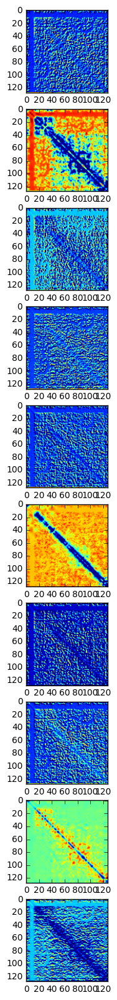

In [51]:
# visualization
def draw_color(data, row, col, n):
    plt.subplot(row, col, n)
    plt.imshow(data)
show_size = 10
nb_filter = 10
plt.figure(figsize=(20,20))
layer_output = K.function([model.layers[0].input],
                          [model.layers[1].output])
layers = layer_output([X_train[0:show_size].transpose(0,3,1,2)])[0]
for img_index, filters in enumerate(layers, start=1):
    for filter_index, mat in enumerate(filters):
        pos = (filter_index)*show_size+img_index
        draw_color(mat, nb_filter, show_size, pos)
plt.show()

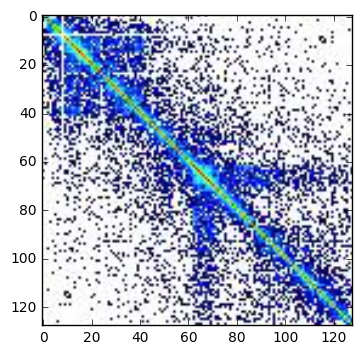

In [85]:
plt.imshow(X_test[214])

In [34]:
from keras import backend as K

first_layer = model.layers[0]
# this is a placeholder tensor that will contain our generated images
input_img = first_layer.input

layer_dict = dict([(layer.name, layer) for layer in model.layers])

layer_name = 'conv5_1'
filter_index = 0  # can be any integer from 0 to 511, as there are 512 filters in that layer

# build a loss function that maximizes the activation
# of the nth filter of the layer considered
layer_output = layer_dict[layer_name].output
loss = K.mean(layer_output[:, filter_index, :, :])

# compute the gradient of the input picture wrt this loss
grads = K.gradients(loss, input_img)[0]

# normalization trick: we normalize the gradient
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

# this function returns the loss and grads given the input picture
iterate = K.function([input_img], [loss, grads])

In [42]:
import numpy as np
# step size for gradient ascent
step = 0.001
# we start from a gray image with some noise
input_img_data = np.asarray([X_test_transpose[207]])
# run gradient ascent for 20 steps
for i in range(20):
    loss_value, grads_value = iterate([input_img_data])
    input_img_data += grads_value * step

In [46]:
input_img_data.transpose(0,2,3,1).shape

(1, 128, 128, 3)

In [30]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
#     x *= 255
#     x = x.transpose((1, 2, 0))
#     x = np.clip(x, 0, 255).astype('uint8')
    return x

(1, 64, 128, 128)


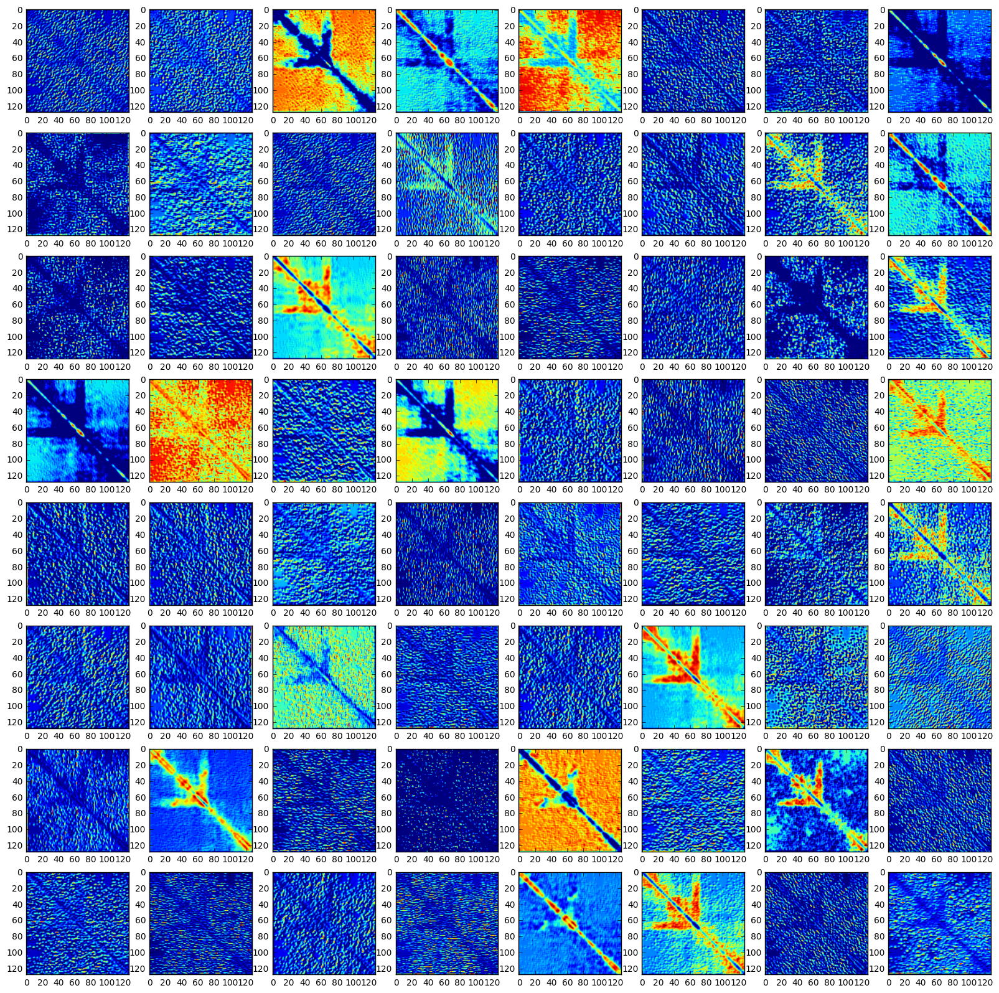

In [16]:
get_feature = theano.function([model.layers[0].input], model.layers[3].output, allow_input_downcast=False)
feat = get_feature(np.asarray([X_test_transpose[index]]))
print feat.shape
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20,20))
for k in range(64):
    axes.flat[k].imshow(feat[0][k])

(1, 128, 64, 64)


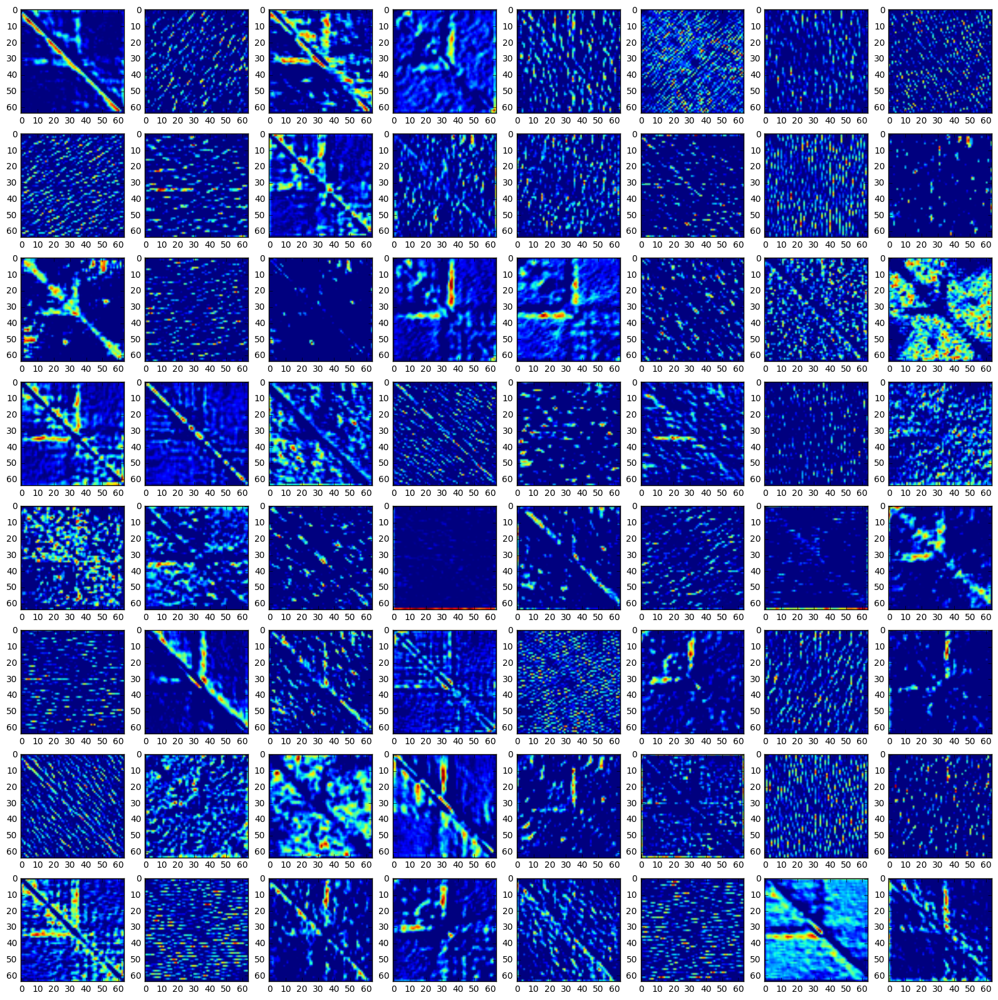

In [21]:
get_feature = theano.function([model.layers[0].input], model.layers[8].output, allow_input_downcast=False)
feat = get_feature(np.asarray([X_test_transpose[index]]))
print feat.shape
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20,20))
for k in range(64):
    axes.flat[k].imshow(feat[0][k*2])

(1, 256, 32, 32)


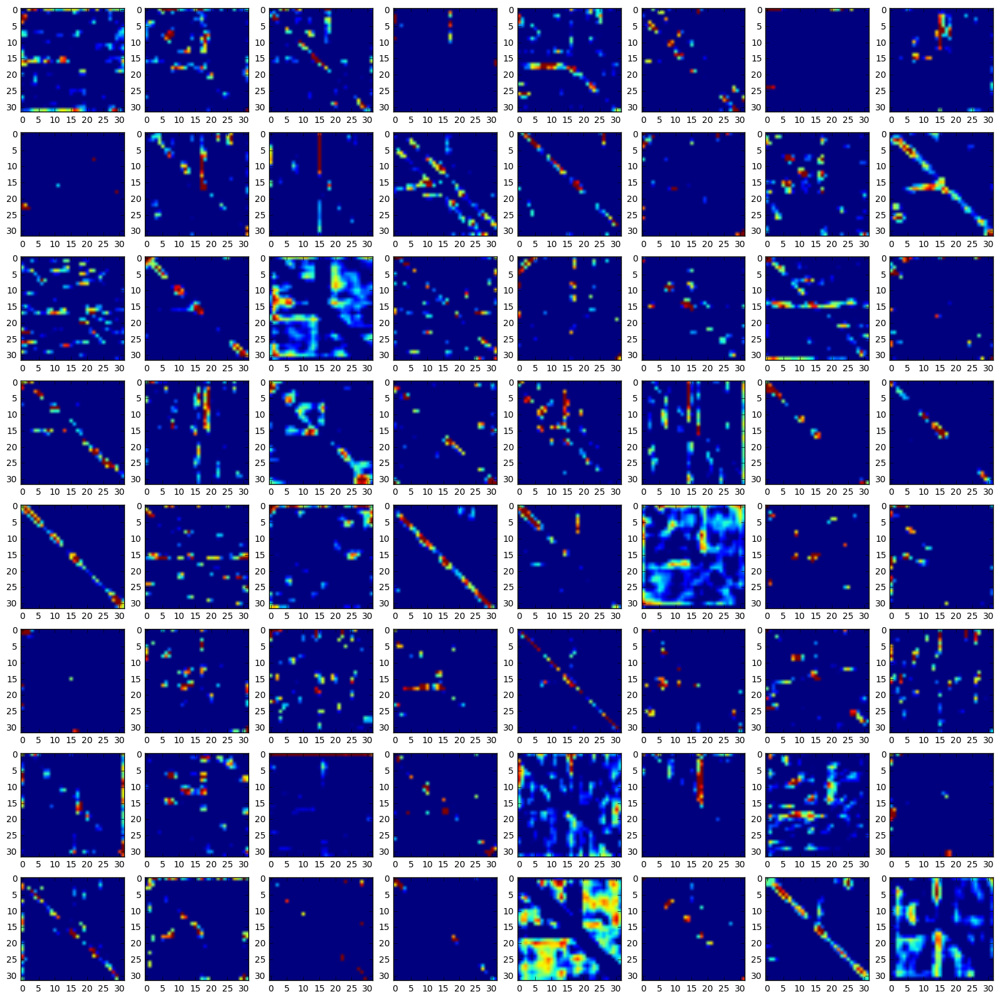

In [31]:
get_feature = theano.function([model.layers[0].input], model.layers[15].output, allow_input_downcast=False)
feat = get_feature(np.asarray([X_test_transpose[index]]))
print feat.shape
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20,20))
for k in range(64):
    axes.flat[k].imshow(deprocess_image(feat[0][k*4]))

(1, 512, 16, 16)


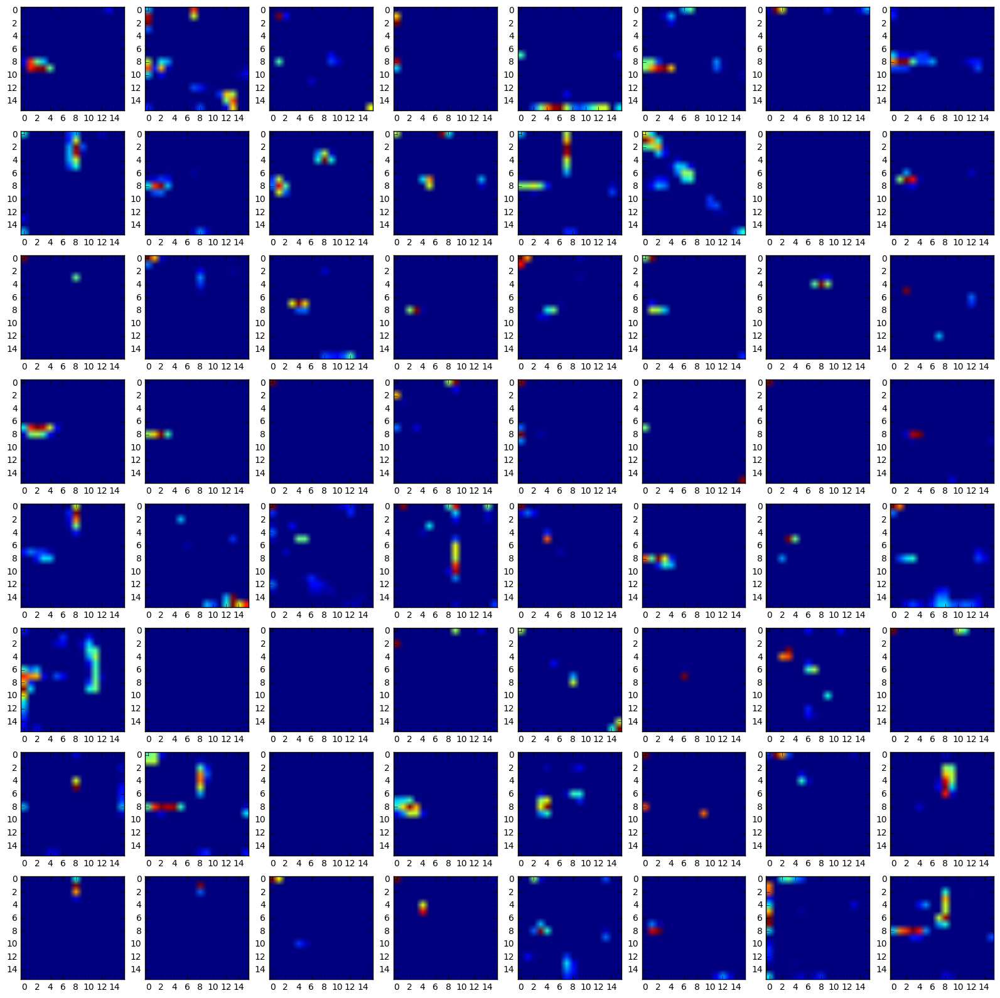

In [23]:
get_feature = theano.function([model.layers[0].input], model.layers[22].output, allow_input_downcast=False)
feat = get_feature(np.asarray([X_test_transpose[index]]))
print feat.shape
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20,20))
for k in range(64):
    axes.flat[k].imshow(feat[0][k*4])

(1, 512, 8, 8)


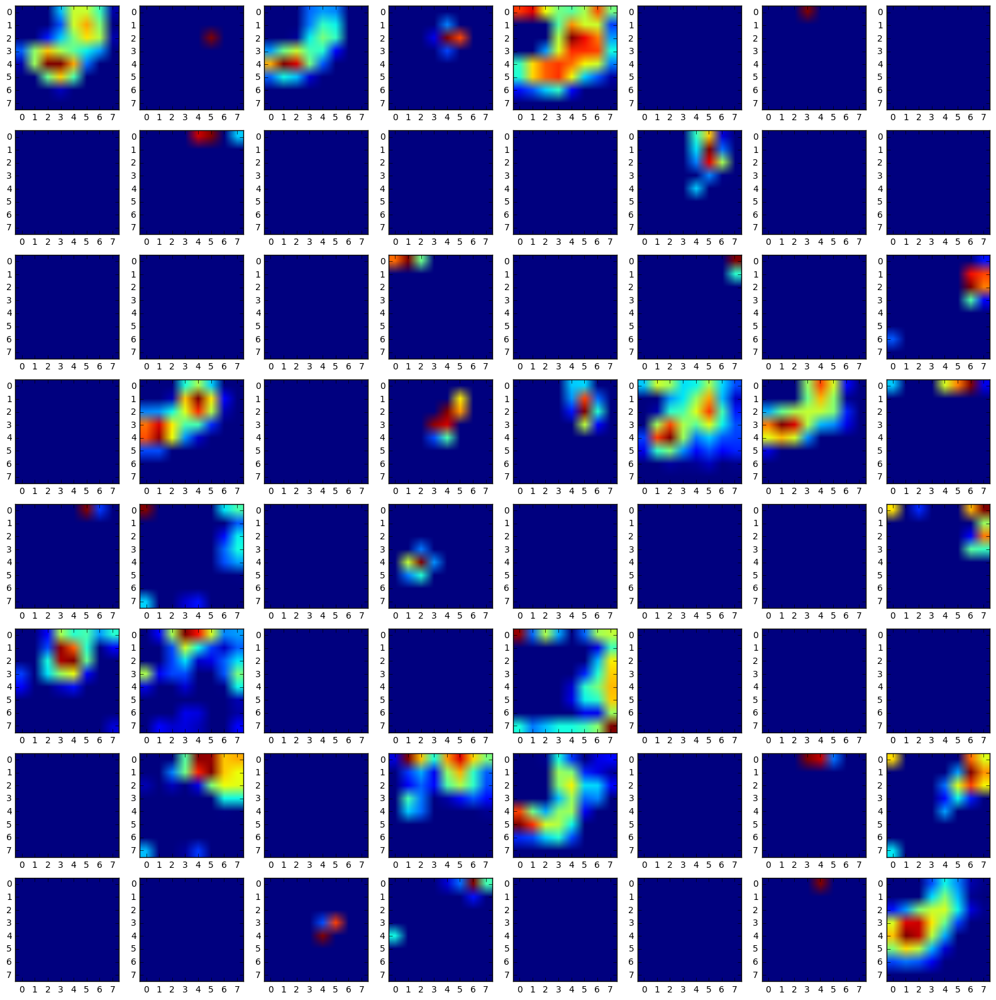

In [24]:
get_feature = theano.function([model.layers[0].input], model.layers[29].output, allow_input_downcast=False)
feat = get_feature(np.asarray([X_test_transpose[index]]))
print feat.shape
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20,20))
for k in range(64):
    axes.flat[k].imshow(feat[0][k*8])

In [22]:
print model.layers[31].get_output_at(-1)

Softmax.0


In [18]:
get_feature = theano.function([model.layers[0].input], model.layers[31].get_output_at(1), allow_input_downcast=False)
feat = get_feature(np.asarray([X_test_transpose[index]]))
print feat.shape
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20,20))
for k in range(64):
    axes.flat[k].imshow(feat[0][k*8])

MissingInputError: ("An input of the graph, used to compute if{}(keras_learning_phase, Elemwise{true_div,no_inplace}.0, Elemwise{mul,no_inplace}.0), was not provided and not given a value.Use the Theano flag exception_verbosity='high',for more information on this error.", keras_learning_phase)

Filter 0 processed in 1s
Filter 1 processed in 1s
Filter 2 processed in 1s
Filter 3 processed in 1s
Filter 4 processed in 1s
Filter 5 processed in 1s
Filter 6 processed in 1s
Filter 7 processed in 1s
Filter 8 processed in 1s
Filter 9 processed in 1s
Filter 10 processed in 1s
Filter 11 processed in 1s
Filter 12 processed in 1s
Filter 13 processed in 1s
Filter 14 processed in 1s
Filter 15 processed in 1s
Filter 16 processed in 1s
Filter 17 processed in 1s
Filter 18 processed in 1s
Filter 19 processed in 1s
Filter 20 processed in 1s
Filter 21 processed in 1s
Filter 22 processed in 1s
Filter 23 processed in 1s
Filter 24 processed in 1s
Filter 25 processed in 1s
Filter 26 processed in 1s
Filter 27 processed in 1s
Filter 28 processed in 1s
Filter 29 processed in 1s
Filter 30 processed in 1s
Filter 31 processed in 1s
Filter 32 processed in 1s
Filter 33 processed in 1s
Filter 34 processed in 1s
Filter 35 processed in 1s
Filter 36 processed in 1s
Filter 37 processed in 1s
Filter 38 processed in

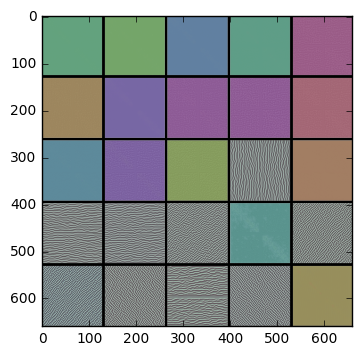

In [70]:
import time
layer_name = 'conv1_2'
img_width = 128
img_height = 128

# util function to convert a tensor into a valid image
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    if K.image_dim_ordering() == 'th':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x


# this is the placeholder for the input images
input_img = model.input

# get the symbolic outputs of each "key" layer (we gave them unique names).
layer_dict = dict([(layer.name, layer) for layer in model.layers[1:]])


def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + 1e-5)


kept_filters = []
for filter_index in range(0, 64):
    #print('Processing filter %d' % filter_index)
    start_time = time.time()

    # we build a loss function that maximizes the activation
    # of the nth filter of the layer considered
    layer_output = layer_dict[layer_name].output
    if K.image_dim_ordering() == 'th':
        loss = K.mean(layer_output[:, filter_index, :, :])
    else:
        loss = K.mean(layer_output[:, :, :, filter_index])

    # we compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, input_img)[0]

    # normalization trick: we normalize the gradient
    grads = normalize(grads)

    # this function returns the loss and grads given the input picture
    iterate = K.function([input_img], [loss, grads])

    # step size for gradient ascent
    step = 1.

    # we start from a gray image with some random noise
    input_img_data = np.asarray([X_test_transpose[207]])
#     if K.image_dim_ordering() == 'th':
#         input_img_data = np.random.random((1, 3, img_width, img_height))
#     else:
#         input_img_data = np.random.random((1, img_width, img_height, 3))
#     input_img_data = (input_img_data - 0.5) * 20 + 128

    # we run gradient ascent for 20 steps
    for i in range(20):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

        if loss_value <= 0.:
            # some filters get stuck to 0, we can skip them
            break

    # decode the resulting input image
    if loss_value > 0:
        img = deprocess_image(input_img_data[0])
        kept_filters.append((img, loss_value))
    end_time = time.time()
    print('Filter %d processed in %ds' % (filter_index, end_time - start_time))

# we will stich the best n**2 filters on a n x n grid.
n = 5

# the filters that have the highest loss are assumed to be better-looking.
# we will only keep the top n**2 filters.
kept_filters.sort(key=lambda x: x[1], reverse=True)
kept_filters = kept_filters[:n * n]

# build a black picture with enough space for
# our n x n filters of size with a 5px margin in between
margin = 5
width = n * img_width + (n - 1) * margin
height = n * img_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

# fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        img, loss = kept_filters[i * n + j]
        stitched_filters[(img_width + margin) * i: (img_width + margin) * i + img_width,
                         (img_height + margin) * j: (img_height + margin) * j + img_height, :] = img

# save image and display
#imsave('feats.jpg', stitched_filters)
plt.imshow(stitched_filters)

Filter 0 processed in 3s
Filter 1 processed in 3s
Filter 2 processed in 6s
Filter 3 processed in 3s
Filter 4 processed in 6s
Filter 5 processed in 3s
Filter 6 processed in 3s
Filter 7 processed in 6s
Filter 8 processed in 6s
Filter 9 processed in 6s
Filter 10 processed in 6s
Filter 11 processed in 6s
Filter 12 processed in 3s
Filter 13 processed in 6s
Filter 14 processed in 3s
Filter 15 processed in 6s
Filter 16 processed in 6s
Filter 17 processed in 6s
Filter 18 processed in 3s
Filter 19 processed in 6s


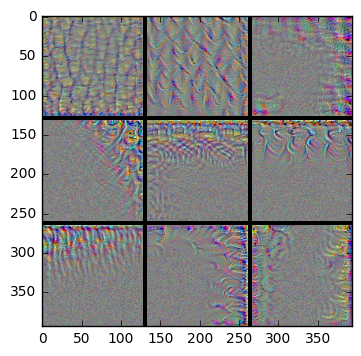

In [35]:
import time
layer_name = 'conv4_3'
img_width = 128
img_height = 128

# util function to convert a tensor into a valid image
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    if K.image_dim_ordering() == 'th':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x


# this is the placeholder for the input images
input_img = model.input

# get the symbolic outputs of each "key" layer (we gave them unique names).
layer_dict = dict([(layer.name, layer) for layer in model.layers[1:]])


def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + 1e-5)


kept_filters = []
for filter_index in range(0, 20):
    #print('Processing filter %d' % filter_index)
    start_time = time.time()

    # we build a loss function that maximizes the activation
    # of the nth filter of the layer considered
    layer_output = layer_dict[layer_name].output
    if K.image_dim_ordering() == 'th':
        loss = K.mean(layer_output[:, filter_index, :, :])
    else:
        loss = K.mean(layer_output[:, :, :, filter_index])

    # we compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, input_img)[0]

    # normalization trick: we normalize the gradient
    grads = normalize(grads)

    # this function returns the loss and grads given the input picture
    iterate = K.function([input_img], [loss, grads])

    # step size for gradient ascent
    step = 0.1

    # we start from a gray image with some random noise
#    input_img_data = np.asarray([X_test_transpose[214]])
    if K.image_dim_ordering() == 'th':
        input_img_data = np.random.random((1, 3, img_width, img_height))
    else:
        input_img_data = np.random.random((1, img_width, img_height, 3))
    input_img_data = (input_img_data - 0.5) * 20 + 128

    # we run gradient ascent for 20 steps
    for i in range(100):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

        if loss_value <= 0.:
            # some filters get stuck to 0, we can skip them
            break

    # decode the resulting input image
    if loss_value > 0:
        img = deprocess_image(input_img_data[0])
        kept_filters.append((img, loss_value))
    end_time = time.time()
    print('Filter %d processed in %ds' % (filter_index, end_time - start_time))

# we will stich the best n**2 filters on a n x n grid.
n = 3

# the filters that have the highest loss are assumed to be better-looking.
# we will only keep the top n**2 filters.
kept_filters.sort(key=lambda x: x[1], reverse=True)
kept_filters = kept_filters[:n * n]

# build a black picture with enough space for
# our n x n filters of size with a 5px margin in between
margin = 5
width = n * img_width + (n - 1) * margin
height = n * img_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

# fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        img, loss = kept_filters[i * n + j]
        stitched_filters[(img_width + margin) * i: (img_width + margin) * i + img_width,
                         (img_height + margin) * j: (img_height + margin) * j + img_height, :] = img

# save image and display
#imsave('feats.jpg', stitched_filters)
plt.imshow(stitched_filters)

In [33]:
type(model.input)

theano.tensor.var.TensorVariable

In [29]:
len(kept_filters)

9

Filter 0 processed in 5s
Filter 1 processed in 5s
Filter 2 processed in 5s
Filter 3 processed in 5s
Filter 4 processed in 5s
Filter 5 processed in 5s
Filter 6 processed in 5s
Filter 7 processed in 5s
Filter 8 processed in 5s
Filter 9 processed in 5s
Filter 10 processed in 5s
Filter 11 processed in 4s
Filter 12 processed in 5s
Filter 13 processed in 4s
Filter 14 processed in 5s
Filter 15 processed in 5s
Filter 16 processed in 5s
Filter 17 processed in 4s
Filter 18 processed in 5s
Filter 19 processed in 4s
Filter 20 processed in 5s
Filter 21 processed in 5s
Filter 22 processed in 5s
Filter 23 processed in 4s
Filter 24 processed in 5s
Filter 25 processed in 5s
Filter 26 processed in 4s
Filter 27 processed in 5s
Filter 28 processed in 5s
Filter 29 processed in 5s
Filter 30 processed in 5s
Filter 31 processed in 5s
Filter 32 processed in 5s
Filter 33 processed in 5s
Filter 34 processed in 5s
Filter 35 processed in 4s
Filter 36 processed in 5s
Filter 37 processed in 5s
Filter 38 processed in

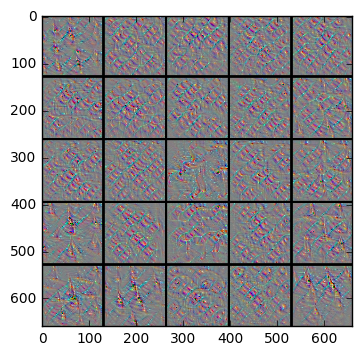

In [55]:
import time
layer_name = 'conv5_3'
img_width = 128
img_height = 128

# util function to convert a tensor into a valid image
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    if K.image_dim_ordering() == 'th':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x


# this is the placeholder for the input images
input_img = model.input

# get the symbolic outputs of each "key" layer (we gave them unique names).
layer_dict = dict([(layer.name, layer) for layer in model.layers[1:]])


def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + 1e-5)


kept_filters = []
for filter_index in range(0, 512):
    #print('Processing filter %d' % filter_index)
    start_time = time.time()

    # we build a loss function that maximizes the activation
    # of the nth filter of the layer considered
    layer_output = layer_dict[layer_name].output
    if K.image_dim_ordering() == 'th':
        loss = K.mean(layer_output[:, filter_index, :, :])
    else:
        loss = K.mean(layer_output[:, :, :, filter_index])

    # we compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, input_img)[0]

    # normalization trick: we normalize the gradient
    grads = normalize(grads)

    # this function returns the loss and grads given the input picture
    iterate = K.function([input_img], [loss, grads])

    # step size for gradient ascent
    step = 1.

    # we start from a gray image with some random noise
    input_img_data = np.asarray([X_test_transpose[207]])
#     if K.image_dim_ordering() == 'th':
#         input_img_data = np.random.random((1, 3, img_width, img_height))
#     else:
#         input_img_data = np.random.random((1, img_width, img_height, 3))
#     input_img_data = (input_img_data - 0.5) * 20 + 128

    # we run gradient ascent for 20 steps
    for i in range(20):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

        if loss_value <= 0.:
            # some filters get stuck to 0, we can skip them
            break

    # decode the resulting input image
    if loss_value > 0:
        img = deprocess_image(input_img_data[0])
        kept_filters.append((img, loss_value))
    end_time = time.time()
    print('Filter %d processed in %ds' % (filter_index, end_time - start_time))

# we will stich the best n**2 filters on a n x n grid.
n = 5

# the filters that have the highest loss are assumed to be better-looking.
# we will only keep the top n**2 filters.
kept_filters.sort(key=lambda x: x[1], reverse=True)
kept_filters = kept_filters[:n * n]

# build a black picture with enough space for
# our n x n filters of size with a 5px margin in between
margin = 5
width = n * img_width + (n - 1) * margin
height = n * img_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

# fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        img, loss = kept_filters[i * n + j]
        stitched_filters[(img_width + margin) * i: (img_width + margin) * i + img_width,
                         (img_height + margin) * j: (img_height + margin) * j + img_height, :] = img

# save image and display
#imsave('feats.jpg', stitched_filters)
plt.imshow(stitched_filters)

In [59]:
import pickle
pickle.dump(kept_filters, open( "kept_filters", "wb" ) )

(128, 128, 3)


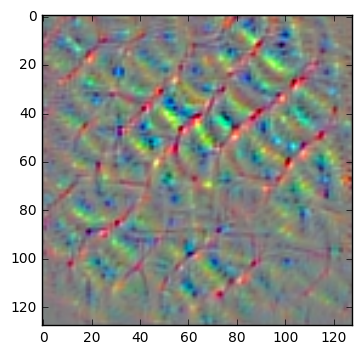

In [67]:
print kept_filters[0][0].shape
plt.imshow(kept_filters[2][0])

In [26]:
layer_output = model.layers[-1].get_output_at(0)
loss = K.mean(layer_output[:, 4])
print loss, layer_output

mean Softmax.0


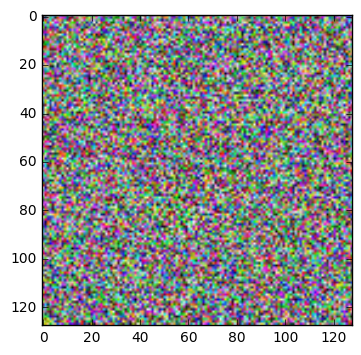

In [57]:
input_img_data = np.random.random((1, img_width, img_height, 3))
input_img_data = (input_img_data - 0.5) * 20 + 128
plt.imshow(input_img_data[0])

In [23]:
plt.imshow(feat[0][2])

(1, 64, 128, 128)

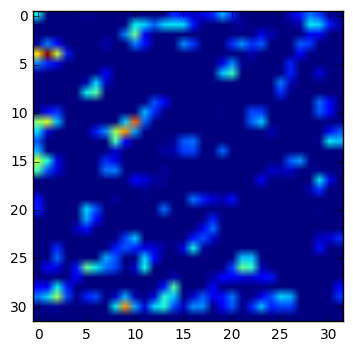

In [20]:
get_feature = theano.function([model.layers[0].input], model.layers[15].output, allow_input_downcast=False)
feat = get_feature(np.asarray([X_test_transpose[602]]))
plt.imshow(feat[0][13])

In [13]:
def extract_hypercolumn(model, layer_indexes, instance):
    layers = [model.layers[li].output for li in layer_indexes]
    get_feature = theano.function([model.layers[0].input], layers,
                                  allow_input_downcast=False)
    feature_maps = get_feature(instance)
    hypercolumns = []
    #print len(feature_maps), feature_maps[0].shape
    for convmap in feature_maps:
        for fmap in convmap[0]:
            upscaled = sp.misc.imresize(fmap, size=(128, 128),
                                        mode="F", interp='bilinear')
            hypercolumns.append(upscaled)

    return np.asarray(hypercolumns)

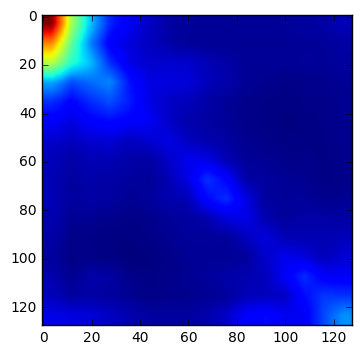

In [60]:
model.predict(np.asarray([test_norm]).transpose(0,3,1,2))

1/1 [==============================] - 0s


array([3])

In [ ]:
# build the VGG16 network
import h5py
from keras import optimizers
from keras.models import Sequential
from keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D
from keras.layers import Activation, Dropout, Flatten, Dense
K.set_image_dim_ordering('th')

filter_size = 20
num_classes = 6
size = 128

weights_path = 'vgg16_weights.h5'

model = Sequential()
model.add(ZeroPadding2D((1, 1), input_shape=(3,size,size)))

# model.add(Convolution2D(32, 20, 20, activation='relu', name='conv0_1'))
# model.add(ZeroPadding2D((1, 1)))
# model.add(Convolution2D(32, 20, 20, activation='relu', name='conv0_2'))
# model.add(MaxPooling2D((2, 2), strides=(2, 2)))

# #model.add(Flatten(input_shape=(64,3,3,3)))

# model.add(ZeroPadding2D((1, 1), input_shape=(64,3,3,3)))

model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(64, 3, 3, activation='relu', name='conv1_2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(128, 3, 3, activation='relu', name='conv2_2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(256, 3, 3, activation='relu', name='conv3_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv4_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))

model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_1'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_2'))
model.add(ZeroPadding2D((1, 1)))
model.add(Convolution2D(512, 3, 3, activation='relu', name='conv5_3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2)))



# load the weights of the VGG16 networks
# (trained on ImageNet, won the ILSVRC competition in 2014)
# note: when there is a complete match between your model definition
# and your weight savefile, you can simply call model.load_weights(filename)
assert os.path.exists(weights_path), 'Model weights not found (see "weights_path" variable in script).'
f = h5py.File(weights_path)
for k in range(f.attrs['nb_layers']):
    if k >= len(model.layers):
        # we don't look at the last (fully-connected) layers in the savefile
        break
    g = f['layer_{}'.format(k)]
    weights = [g['param_{}'.format(p)] for p in range(g.attrs['nb_params'])]
    model.layers[k].set_weights(weights)
f.close()
print('Model loaded.')

# build a classifier model to put on top of the convolutional model
top_model = Sequential()
top_model.add(Flatten(input_shape=model.output_shape[1:]))
top_model.add(Dense(256, activation='relu'))
top_model.add(Dropout(0.5))
top_model.add(Dense(num_classes, activation='softmax'))



# note that it is necessary to start with a fully-trained
# classifier, including the top classifier,
# in order to successfully do fine-tuning
#top_model.load_weights(top_model_weights_path)

# add the model on top of the convolutional base
model.add(top_model)


# set the first 25 layers (up to the last conv block)
# to non-trainable (weights will not be updated)
for layer in model.layers[:25]:
    layer.trainable = False

    
model.summary()

In [ ]:
sgd = SGD(lr=0.001, decay=0.01, momentum=0.9, nesterov=True)
model.compile(loss='categorical_crossentropy', optimizer=sgd, metrics=['accuracy'])

model.fit(X_train_transpose, Y_train, batch_size=50, nb_epoch=50, validation_data=(X_test_transpose, Y_test))

Train on 15000 samples, validate on 1800 samples
Epoch 1/50
15000/15000 [==============================] - 416s - loss: 1.0722 - acc: 0.5295 - val_loss: 0.7074 - val_acc: 0.6567
Epoch 2/50
15000/15000 [==============================] - 417s - loss: 0.7141 - acc: 0.6699 - val_loss: 0.6232 - val_acc: 0.7128
Epoch 3/50
15000/15000 [==============================] - 417s - loss: 0.6378 - acc: 0.6993 - val_loss: 0.5693 - val_acc: 0.7311
Epoch 4/50
15000/15000 [==============================] - 417s - loss: 0.5847 - acc: 0.7221 - val_loss: 0.5492 - val_acc: 0.7383
Epoch 5/50
15000/15000 [==============================] - 417s - loss: 0.5466 - acc: 0.7419 - val_loss: 0.5477 - val_acc: 0.7383
Epoch 6/50
15000/15000 [==============================] - 417s - loss: 0.5173 - acc: 0.7505 - val_loss: 0.5214 - val_acc: 0.7594
Epoch 7/50
10700/15000 [====================>.........] - ETA: 115s - loss: 0.4953 - acc: 0.7709

Processing filter 4


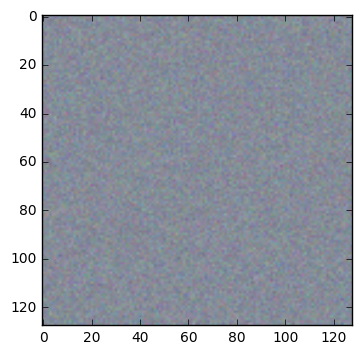

In [16]:
import time
#VGG16 mean values
MEAN_VALUES = np.array([103.939, 116.779, 123.68]).reshape((3,1,1))
 
# util function to convert a tensor into a valid image
def deprocess(x):
    x += MEAN_VALUES # Add VGG16 mean values
 
    x = x[::-1, :, :] # Change from BGR to RGB
    x = x.transpose((1, 2, 0)) # Change from (Channel,Height,Width) to (Height,Width,Channel)
    
    x = np.clip(x, 0, 255).astype('uint8') #clip in [0;255] and convert to int
    return x

# Specify input and output of the network
input_img = model.layers[0].input
layer_output = model.layers[-1].get_output_at(1)

# List of the generated images after learning
kept_images = []
 
# Update coefficient
learning_rate = 10.
 
for class_index in [4]: #130 flamingo, 351 hartebeest, 736 pool table, 850 teddy bear
    print('Processing filter %d' % class_index)
    start_time = time.time()
 
    # The loss is the activation of the neuron for the chosen class
    loss = layer_output[0, class_index]
 
    # we compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, input_img)[0]
 
    # this function returns the loss and grads given the input picture
    # also add a flag to disable the learning phase (in our case dropout)
    iterate = K.function([input_img, K.learning_phase()], [loss, grads])
 
    np.random.seed(1337)  # for reproducibility
    # we start from a gray image with some random noise
    input_img_data = np.random.normal(0, 10, (1,) + model.input_shape[1:]) # (1,) for batch axis
 
    # we run gradient ascent for 1000 steps
    for i in range(1000):
        loss_value, grads_value = iterate([input_img_data, 0]) # 0 for test phase
        input_img_data += grads_value * learning_rate # Apply gradient to image
 
        #print('Current loss value:', loss_value)
 
    # decode the resulting input image and add it to the list
    img = deprocess(input_img_data[0])
    kept_images.append((img, loss_value))
    end_time = time.time()
    #print('Filter %d processed in %ds' % (class_index, end_time - start_time))
    
    
# Compute the size of the grid
n = int(np.ceil(np.sqrt(len(kept_images))))
 
# build a black picture with enough space for the kept_images
img_height = model.input_shape[2]
img_width = model.input_shape[3]
margin = 5
height = n * img_height + (n - 1) * margin
width = n * img_width + (n - 1) * margin
stitched_res = np.zeros((height, width, 3))
 
# fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        if len(kept_images) <= i * n + j:
            break
        img, loss = kept_images[i * n + j]
        stitched_res[(img_height + margin) * i: (img_height + margin) * i + img_height,
                         (img_width + margin) * j: (img_width + margin) * j + img_width, :] = img

        
# save the result to disk
plt.imshow(stitched_res)
#scipy.misc.toimage(stitched_res, cmin=0, cmax=255).save('naive_results_%dx%d.png'

In [50]:
import numpy as np
 
import scipy.misc
import time
import os
import h5py
 
from keras.models import Sequential
from keras.layers import Convolution2D, ZeroPadding2D, MaxPooling2D, Flatten, Dense, Dropout
from keras import backend as K
 
#VGG16 mean values
MEAN_VALUES = np.array([103.939, 116.779, 123.68]).reshape((3,1,1))
 
# path to the model weights file.
weights_path = 'vgg16_weights.h5'
 
# util function to convert a tensor into a valid image
def deprocess(x):
    x += MEAN_VALUES # Add VGG16 mean values
 
    x = x[::-1, :, :] # Change from BGR to RGB
    x = x.transpose((1, 2, 0)) # Change from (Channel,Height,Width) to (Height,Width,Channel)
    
    x = np.clip(x, 0, 255).astype('uint8') #clip in [0;255] and convert to int
    return x
 
# Creates a VGG16 model and load the weights if available (see https://gist.github.com/baraldilorenzo/07d7802847aaad0a35d3)
def VGG_16(w_path=None):
    model = Sequential()
    model.add(ZeroPadding2D((1,1),input_shape=(3,224,224)))
    model.add(Convolution2D(64, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(64, 3, 3, activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
 
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(128, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(128, 3, 3, activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
 
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, 3, 3, activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
 
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, 3, 3, activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
 
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, 3, 3, activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, 3, 3, activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
 
    model.add(Flatten())
    model.add(Dense(4096, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(4096, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1000, activation='linear')) # avoid softmax (see Simonyan 2013)
 
    if w_path:
        model.load_weights(w_path)
 
    return model
 
# Creates the VGG models and loads weights
model = VGG_16(weights_path)
 
# Specify input and output of the network
input_img = model.layers[0].input
layer_output = model.layers[-1].output

print layer_output
print model.layers
 
# List of the generated images after learning
# kept_images = []
 
# # Update coefficient
# learning_rate = 500.
 
# for class_index in [130, 351, 736, 850]: #130 flamingo, 351 hartebeest, 736 pool table, 850 teddy bear
#     print('Processing filter %d' % class_index)
#     start_time = time.time()
 
#     # The loss is the activation of the neuron for the chosen class
#     loss = layer_output[0, class_index]
 
#     # we compute the gradient of the input picture wrt this loss
#     grads = K.gradients(loss, input_img)[0]
 
#     # this function returns the loss and grads given the input picture
#     # also add a flag to disable the learning phase (in our case dropout)
#     iterate = K.function([input_img, K.learning_phase()], [loss, grads])
 
#     np.random.seed(1337)  # for reproducibility
#     # we start from a gray image with some random noise
#     input_img_data = np.random.normal(0, 10, (1,) + model.input_shape[1:]) # (1,) for batch axis
 
#     # we run gradient ascent for 1000 steps
#     for i in range(1000):
#         loss_value, grads_value = iterate([input_img_data, 0]) # 0 for test phase
#         input_img_data += grads_value * learning_rate # Apply gradient to image
 
#         print('Current loss value:', loss_value)
 
#     # decode the resulting input image and add it to the list
#     img = deprocess(input_img_data[0])
#     kept_images.append((img, loss_value))
#     end_time = time.time()
#     print('Filter %d processed in %ds' % (class_index, end_time - start_time))
 
 
# #Compute the size of the grid
# n = int(np.ceil(np.sqrt(len(kept_images))))
 
# # build a black picture with enough space for the kept_images
# img_height = model.input_shape[2]
# img_width = model.input_shape[3]
# margin = 5
# height = n * img_height + (n - 1) * margin
# width = n * img_width + (n - 1) * margin
# stitched_res = np.zeros((height, width, 3))
 
# # fill the picture with our saved filters
# for i in range(n):
#     for j in range(n):
#         if len(kept_images) <= i * n + j:
#             break
#         img, loss = kept_images[i * n + j]
#         stitched_res[(img_height + margin) * i: (img_height + margin) * i + img_height,
#                          (img_width + margin) * j: (img_width + margin) * j + img_width, :] = img
 
# # save the result to disk
# scipy.misc.toimage(stitched_res, cmin=0, cmax=255).save('naive_results_%dx%d.png' % (n, n)) # Do not use scipy.misc.imsave because it will normalize the image pixel value between 0 and 255

Elemwise{add,no_inplace}.0
[<keras.layers.convolutional.ZeroPadding2D object at 0x7f11f1541c90>, <keras.layers.convolutional.Convolution2D object at 0x7f11f1ce8f10>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11fce7d910>, <keras.layers.convolutional.Convolution2D object at 0x7f11f2bbab50>, <keras.layers.pooling.MaxPooling2D object at 0x7f11f1ce5390>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11f1ce5810>, <keras.layers.convolutional.Convolution2D object at 0x7f11f1c84450>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11f1cb30d0>, <keras.layers.convolutional.Convolution2D object at 0x7f11f1cb3790>, <keras.layers.pooling.MaxPooling2D object at 0x7f11fc0d3050>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11fc0d3850>, <keras.layers.convolutional.Convolution2D object at 0x7f1207870b90>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f1207870e10>, <keras.layers.convolutional.Convolution2D object at 0x7f12078b9610>, <keras.layers.convol

In [53]:
print model.layers

[<keras.layers.convolutional.ZeroPadding2D object at 0x7f11f14b1190>, <keras.layers.convolutional.Convolution2D object at 0x7f11f13fab50>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11f1df7cd0>, <keras.layers.convolutional.Convolution2D object at 0x7f11f18415d0>, <keras.layers.pooling.MaxPooling2D object at 0x7f12060d0b90>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11fdf11790>, <keras.layers.convolutional.Convolution2D object at 0x7f11f158c710>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11f23a65d0>, <keras.layers.convolutional.Convolution2D object at 0x7f11f23a6a90>, <keras.layers.pooling.MaxPooling2D object at 0x7f11f23a60d0>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f11f1e963d0>, <keras.layers.convolutional.Convolution2D object at 0x7f11f1e96950>, <keras.layers.convolutional.ZeroPadding2D object at 0x7f1201a83f10>, <keras.layers.convolutional.Convolution2D object at 0x7f1201a83050>, <keras.layers.convolutional.ZeroPadding2D objec

In [67]:
print model.layers[-3].output

Elemwise{mul,no_inplace}.0
